# Домашнее задание №1

В этом домашнем задании вам предлагается обучить модель регрессии для предсказания стоимости автомобилей, а также реализовать веб-сервис для применения построенной модели на новых данных.

> Оценка за домашку = min(ваш балл, 10)


Задания, <font color='#9933CC'>выделенные фиолетовым</font>, требуют от вас написания кода.

А вопросы, <font color='#FF6600'>выделенные оранжевым</font>, текстового ответа.

Оцениваются как код, так и ответы на вопросы. Если нет одного и/или другого, то часть баллов за соответствующее задание без колебаний снимается.

In [141]:
%matplotlib inline

import random
import pandas as pd
import pickle as pi
import numpy as np
import matplotlib.pyplot as plt

import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
from plotly.offline import iplot

from sklearn.svm import SVC
from sklearn.metrics import f1_score,mean_squared_error,r2_score
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.preprocessing import StandardScaler, Normalizer
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import Normalizer

from sklearn.compose import ColumnTransformer
from sklearn.model_selection import GridSearchCV

random.seed(42)
np.random.seed(42)

In [142]:
def assess_model(model, X_train_m, y_train_m, X_test_m, y_test_m, details = 1):
  # fit model
  from sklearn.metrics import r2_score, mean_squared_error as MSE
  print(f"Model: {type(model).__name__}")
  model.fit(X_train_m, y_train_m)
  
  # predict outcome and r2 score
  pred_test = model.predict(X_test_m)
  r2_test = r2_score(y_test_m, pred_test)
  
  pred_train = model.predict(X_train_m)
  r2_train = r2_score(y_train_m, pred_train)
  
  print(f"R2 Test : {r2_test}")
  print(f"R2 Train: {r2_train}")

  print(f"MSE Test {mean_squared_error(y_test_m, pred_test, squared=False)}")
  print(f"MSE Train {mean_squared_error(y_train_m, pred_train, squared=False)}")
  
  # option to display feature coefficients 
  if details == 1:
    model_weights = model.coef_

    if type(model).__name__ in ['Ridge', 'LinearRegression']:
      for _ in list(zip(list(*model_weights), X_train_m)):
        print(_)
    else:
      for _ in list(zip(list(model_weights), X_train_m)):
        print(_)
  return {'pred_test': pd.DataFrame(pred_test, columns = ['pred_test']), 'pred_train': pd.DataFrame(pred_train, columns=['pred_train'])}

In [143]:
def find_alpha(model, X_train_f, y_train_f):
    # set the range for alpha from 0 to 1 with 100 steps
    params = {'alpha': (np.linspace(0, 1, 100))}
    
    # option scoring r2 is available only for Ridge type of model
    if type(model).__name__ in ['Ridge']:
        model_greed = GridSearchCV(model, params, cv = 10, scoring='r2')
    else:
        model_greed = GridSearchCV(model, params, cv = 10)
        
    # fit model
    model_greed.fit(X_train_f, y_train_f)
    
    # print params and scores results
    print(f"model_greed.best_params_: {model_greed.best_params_}")
    print(f"model_greed.best_score_: {model_greed.best_score_}")
    print(f"model_greed.best_index_: {model_greed.best_index_}")

In [144]:
def scale_data(scaler, X_train_s, X_test_s, y_train_s, y_test_s):
    scaler = scaler.fit(X_train_s)

    # fit scaler with test and train objects
    scaler = scaler.fit(X_train_s, y_train_s)
    X_train_scaled = pd.DataFrame(scaler.transform(X_train_s), columns=X_train_s.columns)
    X_test_scaled = pd.DataFrame(scaler.transform(X_test_s), columns=X_test_s.columns)

    # fit scaler with target objects
    scaler = scaler.fit(y_train_s, y_test_s)
    y_test_scaled = pd.DataFrame(scaler.transform(y_test_s), columns=y_test_s.columns)
    y_train_scaled = pd.DataFrame(scaler.transform(y_train_s), columns=y_train_s.columns)
    return {'X_train': X_train_scaled, 'X_test': X_test_scaled, 'y_test': y_test_scaled, 'y_train': y_train_scaled}

In [145]:
def categorical_cleanup(df):
    """Perform basic clean up of categorical data (lower case/strip/space)

    Args:
        df (_type_): data frame to cleaned up (categorical columns only)
    """
    cat_columns = [col for col in df.columns if df[col].dtype=="O"]
    print(f'Following categorical columns will be cleaned up {cat_columns}')
    for _ in cat_columns:    
        df[_] = df[_].str.lower()
        df[_] = df[_].str.strip()
        df[_] = df[_].str.replace(" ", "")
    return df

In [146]:
def replace_outlier(df, column, lower_quintile=0.1, upper_quintile=0.9):
    """Replace outliers with mean

    Args:
        df (_type_): data frame with outliers
        column (_type_): column in which outliers need to be replaced
        lower_quintile (float, optional): lower range for quartile. Defaults to 0.1.
        upper_quintile (float, optional): upper range for quartile. Defaults to 0.9.

    Returns:
        _type_: data frame with replaced outliers for selected column
    """
    Q1 = df[column].quantile(lower_quintile)
    Q3 = df[column].quantile(upper_quintile)
    IQR = Q3-Q1
    fence_low  = Q1-IQR
    fence_high = Q3+IQR
    df_out = df.copy()
    outliers = ~df_out[column].between(fence_low, fence_high, inclusive='neither')
    ave = df_out.loc[~outliers, column].mean()
    df_out.loc[outliers, column] = ave
    return df_out

In [147]:
def split_torque(df):
    # if we take a look on the possible torque values here https://www.researchgate.net/figure/The-raw-data-set-for-20-automobile-engines-Torque-versus-RPM_fig1_264228339
    # we can notice that it is starting from 90+

    # lets find min and max torque to set a range
    trq = pd.to_numeric(df['torque'].str.extract(r"(?P<torque>\d{1,}.?\d+)[nNm]").torque)
    print(f"Torque nNm - Min: {trq.min()}  Max: {trq.max()}")

    # lets find min and max kgm to set a range
    trq = pd.to_numeric(df['torque'].str.extract(r"(?P<torque>\d{1,}.?\d+)[kgm]").torque)
    print(f"Torque kgm - Min: {trq.min()}  Max: {trq.max()}")

    # if torque < 51 we can * 9.8
    df['torque'] = df['torque'].str.replace(',', '')
    df['torque'] = df['torque'].str.replace('.', '')

    df['min_torque_rpm'] = df['torque'].str.extract(r"^(?P<torque_new>\d{1,}\.\d+|\d+).*$").torque_new
    df['rpm'] = df['torque'].str.extract(r"^.*(\@ |at )(?P<rpm>\d+).*$").rpm

    # lets move to numeric
    df['min_torque_rpm'] = pd.to_numeric(df['min_torque_rpm'])
    df['rpm'] = pd.to_numeric(df['rpm'])

    #  lets time all torque value < 51 to 9.8
    df['min_torque_rpm'] = df['min_torque_rpm'].apply(lambda _: _ * 9.8 if _ < 51 else _)

    return df

In [148]:
def data_clean(df):
    # lets remove spaces make lower case etc.
    for _ in ['mileage', 'engine', 'max_power']:
        df[_] = df[_].str.lower()
        df[_] = df[_].str.strip()
        df[_] = df[_].str.replace(" ", "")

    # lets remove all possible string patterns
    df['mileage'] = df['mileage'].str.replace("kmpl", "")
    df['mileage'] = df['mileage'].str.replace("km/kg", "")
    df['max_power'] = df['max_power'].str.replace("bhp", "")
    df['engine'] = df['engine'].str.replace("cc", "")

    # lets cast to float
    for _ in ['mileage', 'engine', 'max_power']:
        df[_] = pd.to_numeric(df[_], errors='coerce')

    return df

In [149]:
def fill_nan(df_test, df_train):
    # columns to use (hardcoded but can be defined dynamically decoded to make more readable)
    columns_to_fill_na = ['mileage', 'engine', 'max_power', 'rpm', 'min_torque_rpm', 'seats']

    # fill mean for train
    df_train[columns_to_fill_na] = df_train[columns_to_fill_na].fillna(df_train[columns_to_fill_na].median(numeric_only=True))

    # fill mean from train into test
    for _ in columns_to_fill_na:
        df_test[_] = pd.to_numeric(df_test[_], errors='coerce')
        df_train[_] = pd.to_numeric(df_train[_], errors='coerce')
        m_to_fill = df_train[_].mean()
        df_test[_].fillna(m_to_fill, inplace = True)
    return [df_train, df_test]

In [150]:
def encode(df, features=[], load_encoder=False, save_encoder=True):
    # if we need to train new encoder
    if load_encoder == False:
        OH_encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
        OH_encoder.fit(df[features])
        # save encoder after training
        if save_encoder == True:
            with open('encoder.pickle', 'wb') as f:
                pi.dump(OH_encoder, f)
    else:
        # load previously trained encoder
        with open('encoder.pickle', 'rb') as f:
            OH_encoder = pi.load(f)
    
    # perform transform for passed features
    OH_cols_test = pd.DataFrame(OH_encoder.transform(df[features]))
    OH_cols_test.columns = OH_encoder.get_feature_names_out()
    
    return df.join(OH_cols_test)

Ниже ответьте на вопрос <font color='#FF6600'>
"Для чего фиксируем сиды в домашках?"</font>

In [151]:
print("Для воспроизводимости результатов экспериментов. Любой кто запустит данный код получит одинаковый результат (42 - отсылка к 'Автостопом по Галактике")

Для воспроизводимости результатов экспериментов. Любой кто запустит данный код получит одинаковый результат (42 - отсылка к 'Автостопом по Галактике


# Часть 1 (2.5 балла + 0.75) | EDA

## Простейший EDA и обработка признаков (1.5 балла + 0.25)

In [152]:
df_train = pd.read_csv('https://raw.githubusercontent.com/hse-mlds/ml/main/hometasks/HT1/cars_train.csv')
df_test = pd.read_csv('https://raw.githubusercontent.com/hse-mlds/ml/main/hometasks/HT1/cars_test.csv')

print("Train data shape:", df_train.shape)
print("Test data shape: ", df_test.shape)

ds_train = df_train.copy()
ds_test = df_test.copy()

Train data shape: (6999, 13)
Test data shape:  (1000, 13)


(0.15 балла) <font color='#9933CC'>Отобразите 10 **случайных** строк тренировочного датасета</font>

In [153]:
df_train.sample(10).style.background_gradient(cmap='pink_r')

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
6565,Renault KWID Climber 1.0 MT BSIV,2019,300000,35000,Petrol,Individual,Manual,First Owner,23.01 kmpl,999 CC,67 bhp,91Nm@ 4250rpm,5.000000
2943,Maruti Wagon R LXI,2013,225000,58343,Petrol,Trustmark Dealer,Manual,First Owner,21.79 kmpl,998 CC,67.05 bhp,90Nm@ 3500rpm,5.000000
2024,Hyundai i20 Asta 1.2,2013,360000,30000,Petrol,Individual,Manual,First Owner,18.5 kmpl,1197 CC,82.85 bhp,113.7Nm@ 4000rpm,5.000000
263,Hyundai i20 1.2 Asta,2010,300000,70000,Petrol,Individual,Manual,First Owner,17.0 kmpl,1197 CC,80 bhp,"11.4 kgm at 4,000 rpm",5.000000
4586,Skoda Octavia L and K 1.9 TDI MT,2005,250000,120000,Diesel,Individual,Manual,Third Owner,16.4 kmpl,1896 CC,90 bhp,"21.4@ 1,900(kgm@ rpm)",5.000000
4479,Maruti Ciaz ZXi,2016,700000,20000,Petrol,Individual,Manual,First Owner,20.73 kmpl,1373 CC,91.1 bhp,130Nm@ 4000rpm,5.000000
4881,Hyundai Grand i10 1.2 Kappa Magna BSIV,2017,445000,27000,Petrol,Individual,Manual,First Owner,18.9 kmpl,1197 CC,81.86 bhp,113.75nm@ 4000rpm,5.000000
3583,Ford Ecosport 1.5 DV5 MT Trend,2016,515000,68609,Diesel,Dealer,Manual,First Owner,22.7 kmpl,1498 CC,89.84 bhp,204Nm@ 2000-2750rpm,5.000000
6361,Hyundai Verna 1.4 VTVT,2014,500000,33400,Petrol,Individual,Manual,First Owner,17.43 kmpl,1396 CC,105.5 bhp,135.3Nm@ 5000rpm,5.000000
4108,Hyundai i20 Era 1.2,2015,490000,45900,Petrol,Individual,Manual,Second Owner,18.6 kmpl,1197 CC,81.83 bhp,114.7Nm@ 4000rpm,5.000000


(0.1 балла) <font color='#9933CC'>Отобразите первые 5 и последние 5 объектов тестового датасета</font>

In [154]:
# display first 5
df_test.head(5)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Mahindra Xylo E4 BS IV,2010,229999,168000,Diesel,Individual,Manual,First Owner,14.0 kmpl,2498 CC,112 bhp,260 Nm at 1800-2200 rpm,7.0
1,Tata Nexon 1.5 Revotorq XE,2017,665000,25000,Diesel,Individual,Manual,First Owner,21.5 kmpl,1497 CC,108.5 bhp,260Nm@ 1500-2750rpm,5.0
2,Honda Civic 1.8 S AT,2007,175000,218463,Petrol,Individual,Automatic,First Owner,12.9 kmpl,1799 CC,130 bhp,172Nm@ 4300rpm,5.0
3,Honda City i DTEC VX,2015,635000,173000,Diesel,Individual,Manual,First Owner,25.1 kmpl,1498 CC,98.6 bhp,200Nm@ 1750rpm,5.0
4,Tata Indica Vista Aura 1.2 Safire BSIV,2011,130000,70000,Petrol,Individual,Manual,Second Owner,16.5 kmpl,1172 CC,65 bhp,96 Nm at 3000 rpm,5.0


In [155]:
# display last 5
df_test.tail()

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
995,Hyundai i10 Magna 1.1L,2008,250000,100000,Petrol,Individual,Manual,Second Owner,19.81 kmpl,1086 CC,68.05 bhp,99.04Nm@ 4500rpm,5.0
996,Hyundai i20 2015-2017 Sportz 1.2,2017,440000,50000,Petrol,Individual,Manual,Second Owner,18.6 kmpl,1197 CC,81.83 bhp,114.7Nm@ 4000rpm,5.0
997,Hyundai i20 Era Diesel,2009,340000,40000,Diesel,Individual,Manual,First Owner,23.0 kmpl,1396 CC,90 bhp,22.4 kgm at 1750-2750rpm,5.0
998,Hyundai i10 Asta,2012,350000,25000,Petrol,Individual,Manual,First Owner,20.36 kmpl,1197 CC,78.9 bhp,111.8Nm@ 4000rpm,5.0
999,Honda City i DTec SV,2016,700000,110000,Diesel,Individual,Manual,First Owner,26.0 kmpl,1498 CC,98.6 bhp,200Nm@ 1750rpm,5.0


(0.1 балла) <font color='#9933CC'>Посчитайте основные статистики как по числовым, так и по категориальным столбцам для трейна и теста</font>. 
> Подсказка: ``.describe()`` с нужным(и) аргументом(-ами)



In [156]:
df_train.describe(include='all').style.background_gradient(cmap='pink_r')

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
count,6999,6999.000000,6999.000000,6999.000000,6999,6999,6999,6999,6797,6797,6803,6796,6797.000000
unique,1924,nan,nan,nan,4,3,2,5,386,120,316,419,nan
top,Maruti Swift Dzire VDI,nan,nan,nan,Diesel,Individual,Manual,First Owner,18.9 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,nan
freq,116,nan,nan,nan,3793,5826,6095,4587,197,885,330,468,nan
mean,nan,2013.818403,639515.197171,69584.615517,nan,nan,nan,nan,nan,nan,nan,nan,5.419008
std,nan,4.053095,808941.911915,57724.001817,nan,nan,nan,nan,nan,nan,nan,nan,0.965767
min,nan,1983.000000,29999.000000,1.000000,nan,nan,nan,nan,nan,nan,nan,nan,2.000000
25%,nan,2011.000000,254999.000000,35000.000000,nan,nan,nan,nan,nan,nan,nan,nan,5.000000
50%,nan,2015.000000,450000.000000,60000.000000,nan,nan,nan,nan,nan,nan,nan,nan,5.000000
75%,nan,2017.000000,675000.000000,97000.000000,nan,nan,nan,nan,nan,nan,nan,nan,5.000000


In [157]:
df_test.describe(include='all').style.background_gradient(cmap='pink_r')

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
count,1000,1000.000000,1000.000000,1000.000000,1000,1000,1000,1000,981,981,981,981,981.000000
unique,621,nan,nan,nan,4,3,2,5,237,88,182,226,nan
top,Maruti Alto 800 LXI,nan,nan,nan,Diesel,Individual,Manual,First Owner,18.6 kmpl,1248 CC,74 bhp,200Nm@ 1750rpm,nan
freq,15,nan,nan,nan,534,837,877,623,23,116,43,57,nan
mean,nan,2013.681000,617901.042000,71393.341000,nan,nan,nan,nan,nan,nan,nan,nan,5.410805
std,nan,4.012149,758553.860710,48486.218662,nan,nan,nan,nan,nan,nan,nan,nan,0.919985
min,nan,1995.000000,31000.000000,1303.000000,nan,nan,nan,nan,nan,nan,nan,nan,4.000000
25%,nan,2011.000000,250000.000000,37000.000000,nan,nan,nan,nan,nan,nan,nan,nan,5.000000
50%,nan,2014.000000,434999.000000,61500.000000,nan,nan,nan,nan,nan,nan,nan,nan,5.000000
75%,nan,2017.000000,670000.000000,100000.000000,nan,nan,nan,nan,nan,nan,nan,nan,5.000000


(0.15 балла) <font color='#9933CC'>Посмотрите, есть ли в датасете пропуски.</font>

<font color='#FF6600'>Если есть, то в каких колонках? - Да, куда без них, ответ в выводе ячейки ниже ('mileage', 'engine', 'max_power', 'torque', 'seats')</font>

In [158]:
# lets combine data sets vertically 
concatenated_df = pd.concat([df_test, df_train])

# list of columns with missing values
missing_cols = []

for _ in concatenated_df.columns:
    miss_v = concatenated_df[_].isna().sum()
    print(f"'{_}' has {miss_v} missed values")
    if miss_v > 0:
        missing_cols.append(_)

print(f"Following columns have missing values in df_test and df_train {missing_cols}")

'name' has 0 missed values
'year' has 0 missed values
'selling_price' has 0 missed values
'km_driven' has 0 missed values
'fuel' has 0 missed values
'seller_type' has 0 missed values
'transmission' has 0 missed values
'owner' has 0 missed values
'mileage' has 221 missed values
'engine' has 221 missed values
'max_power' has 215 missed values
'torque' has 222 missed values
'seats' has 221 missed values
Following columns have missing values in df_test and df_train ['mileage', 'engine', 'max_power', 'torque', 'seats']


(0.1 балла) <font color='#9933CC'>Посмотрите, есть ли в трейне объекты с одинаковым признаковым описанием</font> (целевую переменную следует исключить). Если есть, то сколько?

In [159]:
# lets drop selling_price column
df_train_no_target = df_train.drop('selling_price', axis=1)

# get duplicated rows
df_train_no_target_dup = df_train_no_target[df_train_no_target.duplicated()]

print(f"Train data set without target has {df_train_no_target_dup.shape[0]} duplicated rows")

Train data set without target has 1159 duplicated rows


(0.15 балла) <font color='#9933CC'>Отобразите такие объекты</font>

In [160]:
df_train_no_target_dup

,name,year,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
254,Hyundai Grand i10 Sportz,2017,35000,Petrol,Individual,Manual,First Owner,18.9 kmpl,1197 CC,82 bhp,114Nm@ 4000rpm,5.0
258,Maruti Swift VXI,2012,50000,Petrol,Individual,Manual,Second Owner,18.6 kmpl,1197 CC,85.8 bhp,114Nm@ 4000rpm,5.0
268,Maruti Swift Dzire VXI,2014,70000,Petrol,Individual,Manual,Second Owner,19.1 kmpl,1197 CC,85.8 bhp,114Nm@ 4000rpm,5.0
324,Jaguar XE 2016-2019 2.0L Diesel Prestige,2017,9000,Diesel,Dealer,Automatic,First Owner,13.6 kmpl,1999 CC,177 bhp,430Nm@ 1750-2500rpm,5.0
325,Lexus ES 300h,2019,20000,Petrol,Dealer,Automatic,First Owner,22.37 kmpl,2487 CC,214.56 bhp,202Nm@ 3600-5200rpm,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...
6947,Chevrolet Spark 1.0 LS,2010,60000,Petrol,Individual,Manual,Second Owner,18.0 kmpl,995 CC,62 bhp,90.3Nm@ 4200rpm,5.0
6984,Ford Freestyle Titanium Plus Diesel BSIV,2018,24000,Diesel,Individual,Manual,First Owner,24.4 kmpl,1498 CC,98.63 bhp,215Nm@ 1750-3000rpm,5.0
6989,Maruti Swift Dzire VDI,2015,50000,Diesel,Individual,Manual,First Owner,26.59 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0
6997,Tata Indigo CR4,2013,25000,Diesel,Individual,Manual,First Owner,23.57 kmpl,1396 CC,70 bhp,140Nm@ 1800-3000rpm,5.0


(0.15 балла) <font color='#9933CC'>Удалите повторяющиеся строки</font>. Если при одинаковом признаковом описании цены на автомобили отличаются, то оставьте первую строку по этому автомобилю

In [161]:
# lets allocated duplicates from df train
duplicates_from_train = df_train[df_train.duplicated()]

# lets drop duplicates from df train
removed_duplicates_from_train = df_train.drop_duplicates()

# lets create tmp df without target column price from train but removed duplicates
train_without_target_tmp = removed_duplicates_from_train.drop('selling_price', axis=1)

# lets allocate duplicates from df train without target
removed_duplicates_keep_first = train_without_target_tmp[train_without_target_tmp.duplicated(keep='first')]

# lets remove all previously found duplicates
index_for_all_duplicates  = list(removed_duplicates_keep_first.index) + list(duplicates_from_train.index)
df_train = df_train.iloc[list(set(df_train.index) - set(index_for_all_duplicates))]

In [162]:
assert df_train.shape == (5840, 13)

(0.1 балла) Чтоб все было по красоте, <font color='#9933CC'>обновите индексы строк таким образом, чтобы они шли от 0 без пропусков</font>

In [163]:
df_train.reset_index(drop= True , inplace= True )

Вы могли заметить, что с признаками ``mileage, engine, max_power и torque`` всё не слава богу. Давайте починим.

(0.25 балла) Задача такая: 
<font color='#9933CC'>
* убрать единицы измерения для признаков ``mileage, engine, max_power``. 
* кастануть эти столбцы столбцы к ``float``.
* удалить столбец ``torque``
</font>

> Все действия нужно производить над обоими датасетами

---
**Доп (0.25 балла):**
* <font color='#9933CC'>Вместо удаления признак `torque` разделите на два: собственно `torque` и `max_torque_rpm`.</font> Учтите единицы измерения. Они разные ☹

In [164]:
# split torque for train
df_train = split_torque(df = df_train)

# split torque for test
df_test = split_torque(df = df_test)

Torque nNm - Min: 51.0  Max: 789.0
Torque kgm - Min: 4.8  Max: 38.7
Torque nNm - Min: 48.0  Max: 620.0
Torque kgm - Min: 6.1  Max: 32.1


In [165]:
df_test = data_clean(df=df_test)
df_train = data_clean(df=df_train)

(0.15 балла) <font color='#9933CC'>Заполните пропуски в столбцах медианами. Убедитесь, что после заполнения пропусков не осталось</font>

> Обратите внимание, что, по уму, нужно посчитать медиану по трейну и этим средним заполнять пропуски в тесте. Так же делаем, если, например, стандартизируем признаки.



In [166]:
df_train, df_test = fill_nan(df_test=df_test, df_train=df_train)

In [167]:
# fill nan for torque with empty str ''
df_train[['torque']] = df_train[['torque']].fillna('')
df_test[['torque']] = df_test[['torque']].fillna('')


(0.1 балла) Теперь, когда не осталось пропусков, можно <font color='#9933CC'>преобразовать столбцы к более подходящим типам (``engnine`` и ``seats`` к int)
</font>

Ниже ответьте, <font color='#FF6600'>почему (хоть мы этого и не делаем) ``seats``, возможно, лучше сделать переменной категориальной, а не целочисленной. - Если признак seats будет категориальным возможно это скажется на точности и обучаемости модели. Модели легче будет обрабатывать значения и вариативность значений и количество уникальных категорий в seats не очень большое 1-14. Если бы их было очень много то скорее при большом количестве признаков это добавляло бы много "шума" для модели.</font>

In [168]:
print("Если признак seats будет категориальным возможно это скажется на точности и обучаемости модели. Модели легче будет обрабатывать значения и вариативность значений и количество уникальных категорий в seats не очень большое 1-14")
for _ in ['engine', 'seats']:
    df_test[_] = df_test[_].astype(int)
    df_train[_] = df_train[_].astype(int)

Если признак seats будет категориальным возможно это скажется на точности и обучаемости модели. Модели легче будет обрабатывать значения и вариативность значений и количество уникальных категорий в seats не очень большое 1-14


## Визуализации (1 балл + 0.5)

Визуализировать нам надо не так уж и много. Во-первых, хотелось бы, в принципе, увидеть как распределены значения признаков. Также хотелось бы понять, насколько признаки скоррелированы между собой и с целевой переменной. А ещё неплохо бы посмотреть, не оказалось ли так, что тестовые данные распределены иначе, чем трейн.

Этим всем и предлагаем вам заняться.

(0.25 балла) <font color='#9933CC'>Посторойте попарные распределения всех числовых признаков для трейна.</font>

> ``sns.paiplot()`` позволяет сделать это в одну строчку

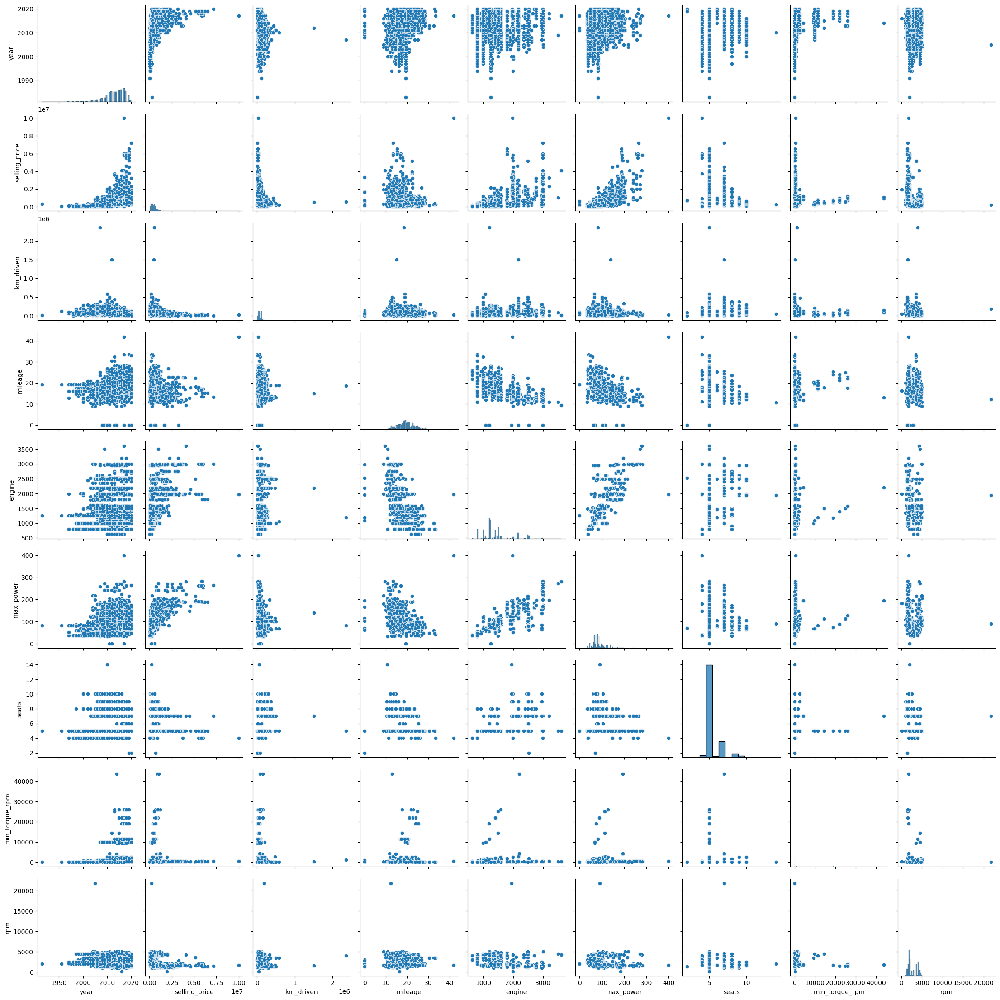

In [169]:
# lets check that amount of numeric columns is equal in train and test and no nan in both sets
assert(len(df_train.select_dtypes(include=np.number).columns) == len(df_train.select_dtypes(include=np.number).columns))
assert df_train.shape == (5840, 15)
assert df_test.shape == (1000, 15)
assert not (df_test.isnull().values.any())
assert not (df_train.isnull().values.any())

# lets build a plot for train with numeric columns <--- run it
sns.pairplot(df_train, vars=df_train.select_dtypes(include=np.number).columns)
plt.show()

Этот график не такой информативный, как можно было бы построить, беря признаки по отдельности. Но он позволяет сделать некоторые (возможно, далеко идущие) выводы. Впрочем, со многими из них (если не со всеми) вы бы справились умозрительно. Однако всегда приятно делать выводы, основываясь на данных.



* <font color='#FF6600'> Что можно сказать о связи предикторов с целевой переменной?
* * <font color='#FF6600'>  Как мне кажется, количество сидений не оказывает существенного влияния на целевой признак (кстати поэтому их, наверное, можно было не переводить из категориальной категории в скалярную). В то же время я бы выделил как средне зависимые такие признаки как max_power и двигатель так как судя по графикам нет очень явной корреляции или зависимости. Из наиболее значимых я бы отметил: year, km_driven mileage, torque.
* А о корреляциях признаков? </font>
* * <font color='#FF6600'> Наиболее кореллируемы признаки выглядяи следующие: year, km_driven mileage, torque. В тоже время количество сидение или мощность не показали сильной корреляции с целевой перемееной.

(0.25 балла) <font color='#9933CC'>Постройте pairplot по тестовым данным</font> и ответьте на вопрос <font color='#FF6600'>"Похожими ли оказались совокупности при разделении на трейн и тест?"</font>

<font color='#FF6600'> При сравнении данных из тренировочного и тестового дата сетов я бы отметил следующие признаки, которые потенциально имеют определённые различия:
 - rpm значение из torque на тренировочном дата сете имеет большую корреляцию с ценой автомобиля в то же время на тестовом корреляция заметно меньше
 - km_driven в тестовом дата сете так же имеет явно менее выраженную корреляцию с ценой
   - хотя возможно это связано с тем что данных в тестовом наборе намного меньше!

Для всех остальных признаком я бы усреднённо сказал, что корреляции сопоставимые </font>


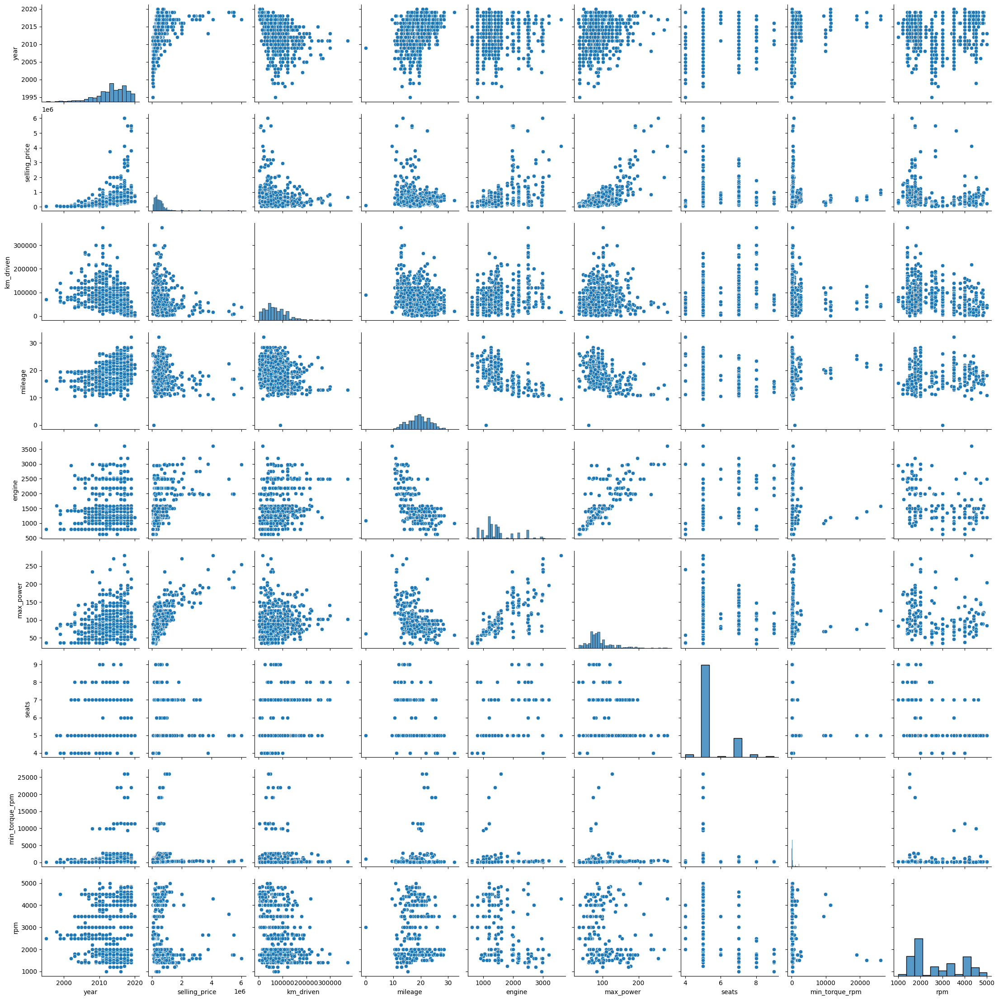

In [170]:
# lets build a plot for test with numeric columns <--- run it
sns.pairplot(df_test, vars=df_test.select_dtypes(include=np.number).columns)
plt.show()

(0.25 балла) <font color='#9933CC'>Для трейна давайте построим тепловую карту (heatmap из библиотеки seaborn) попарных корреляций числовых колонок</font>

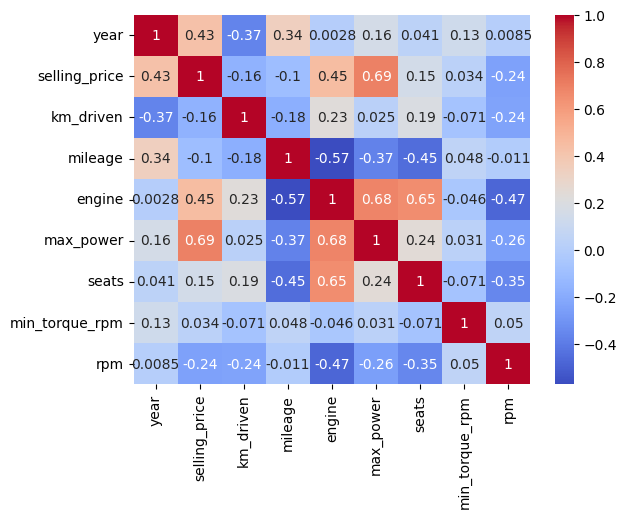

In [171]:
# lets build a matrix for train with numeric columns <--- run it
numeric_columns = df_train.select_dtypes(include=np.number).columns
sns.heatmap(df_train[numeric_columns].corr(), cmap='coolwarm', annot=True)
plt.show()

Ответьте, пожалуйста, на вопросы: 
* <font color='#FF6600'>Какие 2 признака наименее скоррелированы между собой?</font>
* * <font color='#FF6600'> seats <> year и year <> engine
* <font color='#FF6600'>Между какими наблюдается довольно сильная положительная линейная зависимость?</font>
* * <font color='#FF6600'> selling_price <> max_power и max_power <> engine, selling_price <> year, engine <> seats
* <font color='#FF6600'>Правильно ли, опираясь на данные, утверждать, что чем меньше год, тем, скорее всего, больше километров проехала машина к дате продажи.</font>
* * <font color='#FF6600'> Судя по данным зависимость скорее обратная. Чем больше год тем болше проехал автомобиль. В матрице корреляция мы видим негоативное значение -0.37

(0.25 балла) <font color='#9933CC'> Отобразите диаграммe рассеяния для наиболее скореллированной пары **признаков** (на трейне) </font>

Text(0, 0.5, 'Max Power')

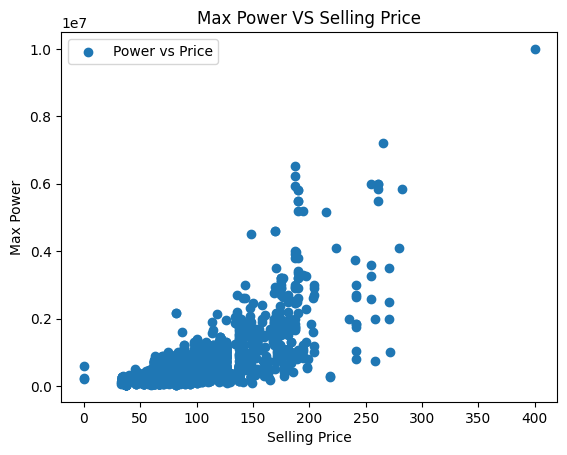

In [172]:
plt.scatter (df_train.max_power, df_train.selling_price)
plt.title("Max Power VS Selling Price")
plt.legend(["Power vs Price"])
plt.xlabel("Selling Price")
plt.ylabel("Max Power")

Text(0, 0.5, 'Engine')

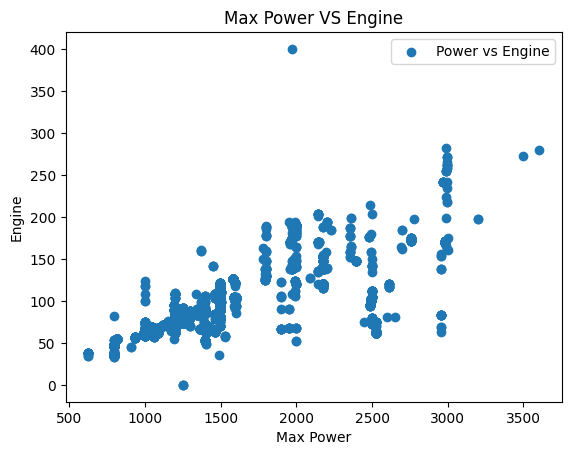

In [173]:
plt.scatter (df_train.engine, df_train.max_power)
plt.title("Max Power VS Engine")
plt.legend(["Power vs Engine"])
plt.xlabel("Max Power")
plt.ylabel("Engine")

### Дополнительные визуализации (бонус 0.5 балла)

Если вам кажется, что мы не попросили вас нарисовать какие-то очень важные зависимости, нарисуйте их и поясните.

Я бы добавил график рассеевания для года и цены автомобиля. Чем больше год тем дороже цена мне кажется этот признак важным для будущей модели


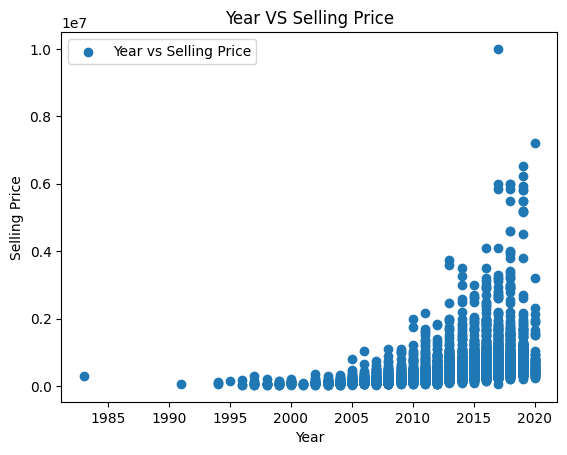

In [174]:
plt.scatter (df_train.year, df_train.selling_price)
plt.title("Year VS Selling Price")
plt.legend(["Year vs Selling Price"])
plt.xlabel("Year")
plt.ylabel("Selling Price")

print("Я бы добавил график рассеевания для года и цены автомобиля. Чем больше год тем дороже цена мне кажется этот признак важным для будущей модели")

# Часть 2 (1.25 балла) | Модель только на вещественных признаках

(0.05 балла) <font color='#9933CC'>В переменные ``y_train`` и ``y_test`` запишите значения целевых переменных. Столбцы ``selling_price`` из датафреймов необходимо удалить. Категориальные (все, кроме ``seats``) столбцы тоже.</font>

In [175]:
# lets build a target for train and test
y_train = pd.DataFrame(df_train['selling_price'].copy())
y_test = pd.DataFrame(df_test['selling_price'].copy())

# check train and test data frames
assert y_test.shape == (1000, 1)
assert y_train.shape == (5840, 1)
assert not (y_test.isnull().values.any())
assert not (y_train.isnull().values.any())

In [176]:
print(f"X data sets will be created with following numeric columns {df_train.select_dtypes(include=np.number).columns} except 'selling_price")

# lets split train and test for all features including target 
X_train = df_train[df_train.select_dtypes(include=np.number).columns].copy()
X_train = X_train.loc[:, X_train.columns != 'selling_price']
X_test = df_test[df_train.select_dtypes(include=np.number).columns].copy()
X_test = X_test.loc[:, X_test.columns != 'selling_price']

# changes from 6 to 8 because of torque column split
assert X_train.shape == (5840, 8)
assert X_test.shape == (1000, 8)
assert not (X_test.isnull().values.any())
assert not (X_train.isnull().values.any())

X data sets will be created with following numeric columns Index(['year', 'selling_price', 'km_driven', 'mileage', 'engine', 'max_power',
       'seats', 'min_torque_rpm', 'rpm'],
      dtype='object') except 'selling_price


(0.2 балла) <font color='#9933CC'>Обучите классическую линейную регрессию с дефолтными параметрами. Посчтитайте $R^2$ и MSE для трейна и для теста</font>

**Замечание:** $R^2$ и MSE для тренировочного и для тестового выводите везде, где требуется обучать модели, даже если в явном виде этого не просят. Иначе непонятно, как понять, насколько успешны наши эксперименты.

In [177]:
model_data = assess_model(model=LinearRegression(), X_train_m=X_train, X_test_m=X_test, y_train_m=y_train, y_test_m=y_test)

Model: LinearRegression
R2 Test : 0.5980016877288545
R2 Train: 0.6008441739686892
MSE Test 480707.9250562808
MSE Train 338250.4437831303
(40198.255760149834, 'year')
(-0.8279526792172507, 'km_driven')
(-929.6882932101043, 'mileage')
(40.289731889271245, 'engine')
(10260.709254381643, 'max_power')
(-33641.811446119595, 'seats')
(-5.681807875250753, 'min_torque_rpm')
(-54.147751261244245, 'rpm')


Запомните правило:

> Использую линейную модель -- стандартизирую фичи

(0.25 балла) <font color='#9933CC'>Воспользуемся им</font>


In [178]:
scale_dfs = scale_data(scaler=StandardScaler(), X_train_s=X_train, X_test_s=X_test, y_train_s=y_train, y_test_s=y_test)

In [179]:
model_data = assess_model(model = LinearRegression(), X_test_m=scale_dfs['X_test'], X_train_m=scale_dfs['X_train'], y_test_m=scale_dfs['y_test'], y_train_m=scale_dfs['y_train'])

Model: LinearRegression
R2 Test : 0.5980016877288533
R2 Train: 0.6008441739686885
MSE Test 0.8978714106117076
MSE Train 0.6317878014264849
(0.30748415829233544, 'year')
(-0.09288958865873259, 'km_driven')
(-0.006920977028608902, 'mileage')
(0.0365447438361942, 'engine')
(0.6063386797151871, 'max_power')
(-0.06172180562161923, 'seats')
(-0.029133277978599943, 'min_torque_rpm')
(-0.11287955160121993, 'rpm')


Не очень результативно.

Зато уже сейчас можем интерпретировать модель. <font color='#FF6600'>"Какой признак оказался наиболее информативным в предсказании цены?"</font>
<font color='#FF6600'> Наиболее информативный признак для предсказания цены является max_power (0.6) и я бы выделил year и engine (0.3+)

(0.25 балла) <font color='#9933CC'>Теперь попробуем Lasso-регрессию.</font> Здесь и дальше обучайте модели на нормализованных признаках

In [180]:
model_data = assess_model(model=Lasso(alpha=0.01), X_test_m=scale_dfs['X_test'], X_train_m=scale_dfs['X_train'], y_test_m=scale_dfs['y_test'], y_train_m=scale_dfs['y_train'])

Model: Lasso
R2 Test : 0.5904408366370558
R2 Train: 0.5997998096389925
MSE Test 0.9062757346003216
MSE Train 0.6326137766133517
(0.29426866542059804, 'year')
(-0.08245278233113482, 'km_driven')
(0.0, 'mileage')
(0.004292147511956692, 'engine')
(0.6167855428394623, 'max_power')
(-0.02652377609188909, 'seats')
(-0.016885079970140632, 'min_torque_rpm')
(-0.10103092423883318, 'rpm')


In [181]:
# find best alpha from 0-1 with 100 iterations
find_alpha(model=Lasso(), X_train_f=scale_dfs['X_train'], y_train_f=scale_dfs['y_train'])

/Users/rbelyy/Downloads/envs/.venv/lib/python3.11/site-packages/sklearn/base.py:1152: UserWarning:

With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator

/Users/rbelyy/Downloads/envs/.venv/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: UserWarning:

Coordinate descent with no regularization may lead to unexpected results and is discouraged.

/Users/rbelyy/Downloads/envs/.venv/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.651e+02, tolerance: 4.350e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.

/Users/rbelyy/Downloads/envs/.venv/lib/python3.11/site

model_greed.best_params_: {'alpha': 0.04040404040404041}
model_greed.best_score_: 0.5828047696335916
model_greed.best_index_: 4


<font color='#FF6600'>Занулила ли L1-регуляризация с параметрами по умолчанию какие-нибудь веса? Почему же?</font>
<font color='#FF6600'> Да, модель занулила два признака  - milage и torque. Так как функция лассо это по сути та же самая регрессия но с добавлением лямбды (Лямбда - гиперпараметр, который мы можем настраивать вручную. Чем больше лямбда, тем сильнее модель штрафуется за величину коэффициентов и их количество - https://habr.com/ru/articles/679232/.) По сути лассо обнуляет коэффициенты тех признаков которые не имеют большого влияния на функцию потерь!

(0.25 балла) <font color='#9933CC'>Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для Lasso-регрессии</font>

Вам пригодится класс [GridSearchCV](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html).

<font color='#FF6600'>Сколько грид-сёрчу пришлось обучать моделей? - model_greed.best_index_ = 4 моделей грид-серч обучал ... если я правильно понял вопрос </font>

<font color='#FF6600'>Какой коэффициент регуляризации у лучшей из перебранных моделей? - Занулились ли какие-нибудь из весов при такой регуляризации? - 0.04 оказался наиболее лучшим из всех перебранных моделей. При этом были занулены веса для фичей engine, mileage, seats, min_torque_rpm разница с первой моделью здесь видится в том что были занулены 2 дополнительных веса для seats и для engine</font>

In [182]:
# lets run lasso model
model_lasso = Lasso(alpha=0.04)
model_data = assess_model(model=model_lasso, X_test_m=scale_dfs['X_test'], X_train_m=scale_dfs['X_train'], y_test_m=scale_dfs['y_test'], y_train_m=scale_dfs['y_train'])

Model: Lasso
R2 Test : 0.5709852986121389
R2 Train: 0.5929181171308235
MSE Test 0.9275516787461924
MSE Train 0.6380296880782088
(0.27497760648084796, 'year')
(-0.052946354560879004, 'km_driven')
(0.0, 'mileage')
(0.0, 'engine')
(0.5947649500742244, 'max_power')
(-0.0, 'seats')
(-0.0, 'min_torque_rpm')
(-0.06305486007512646, 'rpm')


(0.25 балла) <font color='#9933CC'>Перебором по сетке (c 10-ю фолдами) подберите оптимальные параметры для [ElasticNet](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.ElasticNet.html)-регрессии</font>

In [183]:
# find best alpha from 0-1 with 100 iterations
find_alpha(model=ElasticNet(), X_train_f=scale_dfs['X_train'], y_train_f=scale_dfs['y_train'])

/Users/rbelyy/Downloads/envs/.venv/lib/python3.11/site-packages/sklearn/base.py:1152: UserWarning:

With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator

/Users/rbelyy/Downloads/envs/.venv/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: UserWarning:

Coordinate descent with no regularization may lead to unexpected results and is discouraged.

/Users/rbelyy/Downloads/envs/.venv/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.651e+02, tolerance: 4.350e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.

/Users/rbelyy/Downloads/envs/.venv/lib/python3.11/site

/Users/rbelyy/Downloads/envs/.venv/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.069e+03, tolerance: 5.356e-01 Linear regression models with null weight for the l1 regularization term are more efficiently fitted using one of the solvers implemented in sklearn.linear_model.Ridge/RidgeCV instead.

/Users/rbelyy/Downloads/envs/.venv/lib/python3.11/site-packages/sklearn/base.py:1152: UserWarning:

With alpha=0, this algorithm does not converge well. You are advised to use the LinearRegression estimator

/Users/rbelyy/Downloads/envs/.venv/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: UserWarning:

Coordinate descent with no regularization may lead to unexpected results and is discouraged.

/Users/rbelyy/Downloads/envs/.venv/lib/python3.11/site

model_greed.best_params_: {'alpha': 0.07070707070707072}
model_greed.best_score_: 0.5835291075004108
model_greed.best_index_: 7


<font color='#FF6600'>Какие гиперпараметры соответствуют лучшей из перебранных моделей? - лучший результат показала модель ElasticNet с лямбдой = 0.07</font>

In [184]:
# lets run elastic model
model_elastic = ElasticNet(alpha=0.07)
model_data = assess_model(model=model_elastic, X_train_m=scale_dfs['X_train'], y_train_m=scale_dfs['y_train'], X_test_m=scale_dfs['X_test'], y_test_m=scale_dfs['y_test'])

Model: ElasticNet
R2 Test : 0.5653705300621765
R2 Train: 0.5920915460599194
MSE Test 0.933601656260905
MSE Train 0.6386771124285578
(0.27097644798747206, 'year')
(-0.05888370371774033, 'km_driven')
(0.0, 'mileage')
(0.0, 'engine')
(0.5782086305925614, 'max_power')
(-0.0, 'seats')
(-0.0, 'min_torque_rpm')
(-0.07119484651482967, 'rpm')


Предлагаем вам оставить вам попытки заметно улучшить качество модели регуляризацией и перейти к следующей части задания.

# Часть 3 (0.5 балла) | Добавляем категориальные фичи



(0 баллов) <font color='#9933CC'>Из ``df_train`` удалите столбцы с целевой переменной и названием автомобиля.</font>

In [185]:
# lets remove name, selling_price and torque
X_train_cat = df_train.drop(['name', 'selling_price', 'torque'], axis=1)
X_test_cat = df_test.drop(['name', 'selling_price', 'torque'], axis=1)

# lets save selling_price to y test / train
y_train_cat = pd.DataFrame(df_train['selling_price'].copy())
y_test_cat = pd.DataFrame(df_test['selling_price'].copy())

# check data sets
assert X_train_cat.shape == (5840, 12)
assert X_test_cat.shape == (1000, 12)
assert y_train_cat.shape == (5840, 1)
assert y_test_cat.shape == (1000, 1)
assert not (X_test.isnull().values.any())
assert not (X_train.isnull().values.any())

In [186]:
X_train_cat.describe(include='object')

,fuel,seller_type,transmission,owner
count,5840,5840,5840,5840
unique,4,3,2,5
top,Diesel,Individual,Manual,First Owner
freq,3177,5223,5336,3603


(0.5 балла) <font color='#9933CC'>Закодируйте категориалльные фичи и ``seats`` методом OneHot-кодирования</font>

> Обратите внимание, что во избежание мультиколлинеарности следует избавиться от одного из полученных столбцов при кодировании каждого признака методом OneHot. 

In [187]:
# lets encode categorical features 
X_train_cat_encoded = encode(df=X_train_cat, features=['seats', 'fuel', 'owner', 'transmission', 'seller_type'], load_encoder=False, save_encoder=True)
X_test_cat_encoded = encode(df=X_test_cat, features=['seats', 'fuel', 'owner', 'transmission', 'seller_type'], load_encoder=True, save_encoder=False)

# make a copy (just in case) of the original
y_test_cat_encoded = y_test_cat.copy()
y_train_cat_encoded = y_train_cat.copy()

(0.25 балла) <font color='#9933CC'>Переберите параметр регуляризации `alpha` для гребневой (ridge) регрессии с помощью класса `GridSearchCV`.</font> В качестве параметров при объявлении GridSearchCV кроме модели укажите метрику качества $R^2$. Кроссвалидируйтесь по 10-ти фолдам.

<font color='#FF6600'>Удалось ли улучшить качество предсказаний? - предсказание удалось улучшить по сравнению с моделью elastic по метрике r2 c 0.56 до 0.62 что наверное можно считать неплохо почти 5%+ </font>

In [188]:
# find best alpha from 0-1 with 100 iterations
find_alpha(model=Ridge(), X_train_f=X_train_cat_encoded.select_dtypes([np.number]), y_train_f=y_train_cat_encoded)

model_greed.best_params_: {'alpha': 1.0}
model_greed.best_score_: 0.6250760926913388
model_greed.best_index_: 99


In [189]:
# lets apply standard scaler for the train and test data sets
scale_dfs = scale_data(scaler=StandardScaler(), X_train_s=X_train_cat_encoded.select_dtypes([np.number]), X_test_s=X_test_cat_encoded.select_dtypes([np.number]), y_train_s=y_train_cat_encoded, y_test_s=y_test_cat_encoded)


In [190]:
print('Train model - Ridge with scaling')
model_ridge = Ridge(alpha=1)
model_data = assess_model(model=model_ridge, X_train_m=scale_dfs['X_train'], y_train_m=scale_dfs['y_train'], X_test_m=scale_dfs['X_test'], y_test_m=scale_dfs['y_test'])


Train model - Ridge with scaling
Model: Ridge
R2 Test : 0.6299145583455592
R2 Train: 0.6718744134021519
MSE Test 0.861495531252571
MSE Train 0.5728224738938306
(0.2868810064793808, 'year')
(-0.055167725795893914, 'km_driven')
(0.05897076282369934, 'mileage')
(0.07482831998681648, 'engine')
(0.5323655022377889, 'max_power')
(-0.02012995656103234, 'seats')
(-0.021423047375033175, 'min_torque_rpm')
(-0.11899118717495594, 'rpm')
(0.0022088264752390925, 'seats_2')
(0.11834257942150533, 'seats_4')
(-0.024400800968404364, 'seats_5')
(-0.021219546672877083, 'seats_6')
(-0.014912894152751818, 'seats_7')
(0.0060641440731647464, 'seats_8')
(0.004535032549870467, 'seats_9')
(0.00902049699129988, 'seats_10')
(-0.0022799144699206584, 'seats_14')
(0.0005188449942814975, 'fuel_CNG')
(-0.022033474062058397, 'fuel_Diesel')
(0.02843494865926155, 'fuel_LPG')
(0.017646497520120614, 'fuel_Petrol')
(0.021999207096371334, 'owner_First Owner')
(-0.005874650082724847, 'owner_Fourth & Above Owner')
(-0.026324122

In [191]:
print('Train model - Ridge without scaling')
model_ridge = Ridge(alpha=1)
model_data = assess_model(model=model_ridge, X_train_m=X_train_cat_encoded.select_dtypes([np.number]), y_train_m=y_train_cat_encoded, X_test_m=X_test_cat_encoded.select_dtypes([np.number]), y_test_m=y_test_cat_encoded)


Train model - Ridge without scaling
Model: Ridge
R2 Test : 0.6363086889306193
R2 Train: 0.6711624817038788
MSE Test 457230.96028185176
MSE Train 307013.7453504831
(37673.33621172481, 'year')
(-0.491112522825286, 'km_driven')
(7883.2560627001385, 'mileage')
(81.2514240744988, 'engine')
(9044.537413199403, 'max_power')
(-32665.600681158146, 'seats')
(-4.225465406503902, 'min_torque_rpm')
(-58.8070876163623, 'rpm')
(-65808.41720755752, 'seats_2')
(378349.25453903887, 'seats_4')
(-130330.74894940213, 'seats_5')
(-198354.6540743158, 'seats_6')
(-78593.27207885026, 'seats_7')
(-15205.208468741464, 'seats_8')
(12291.538040873016, 'seats_9')
(94653.62502004203, 'seats_10')
(2997.883179108111, 'seats_14')
(-44363.76181343796, 'fuel_CNG')
(-75357.76293827147, 'fuel_Diesel')
(148019.5369576822, 'fuel_LPG')
(-28298.012205483203, 'fuel_Petrol')
(-505224.9509041284, 'owner_First Owner')
(-544561.2154341412, 'owner_Fourth & Above Owner')
(-559582.4708402948, 'owner_Second Owner')
(2151912.1991662583,

# Часть 4 - бонусная (1.5 балла) | Feature Engineering 

В этой части домашнего задания вам предлагается проявить свою креативность для улучшения прогноза модели. Любые другие модели, кроме различных форм линейной (или полиномиальной) регресси, использовать запрещается. А значит, придется работать с признаками

**Что можно попробовать сделать?** (каждый пункт по 0.4 балла, но не больше 2-х баллов в сумме)

1.   *Сгенерировать новые признаки на основе уже существующих:*
    * посчитать произведения // частные признаков (кажется, что посчитать число "лошадей" на литр объема может быть полезно);
    * имеет смысл обратить внимание на визуализации в части с EDA (к примеру, зависимость цены от года выглядит квадратичной, а не линейной; значит, квадрат года нам, скорее всего, принесет больше пользы)

2.   *Добыть новые признаки:*
    * имеем название автомобиля, которое никак не используем (можно спарсить инфу о классе автомобиля или каких-то специфических опциях)
    * можно добавить пороговые признаки вроде "владелец третий или больше" и объединить признаки в некоторые осмысленные правила, например "первый или второй владелец и продавец официальный дилер" (подбирать пороги удобно по диаграммам рассеяния)

3.   *Поработать с уже имеющимися:*
    * далеко не факт, что заполнить пропуск медианой было лучшей идеей (как минимум, можно добавить dummy-столбец для модели, сигнализирующий, что раньше на месте медианы был пропуск -- там где он был, конечно); попробуйте другие способы филлинга;
    * мы не анализировали, есть ли в данных выбросы => никак выбросы не обрабатывали; наиболее простым и, тем не менее, довольно полезным вариантом нахождения выбросов могут послужить boxplot'ы для каждого столбца; что делать с выбросами думайте сами :) -- вариантов довольно много
    * мы толком не смотрели на таргет сам по себе; в нем тоже могут быть неожиданности -- стоит хотя бы проверить
    * можно заметить, что некоторые признаки распределены совсем не нормально; возможно их стоит отлогарифмировать

И так далее...

Feel Free to Try!

In [192]:
# lets take the power of 2 for year column and take the log10 for selling price
def feature_adjust(df):
    if df.shape[1] > 1:
        df['year'] = df['year']**2
    else:
        df['selling_price'] = np.log10(df['selling_price'])
    return df

# apply feature_adjust to scaled and non-scaled data sets
for _ in [X_train_cat_encoded, X_test_cat_encoded, y_train_cat_encoded, y_test_cat_encoded, scale_dfs['X_test'], scale_dfs['X_train'], scale_dfs['y_train'], scale_dfs['y_test']]:
    _ = feature_adjust(_)
    print(f"{_.shape} is adjusted.")


(5840, 35) is adjusted.
(1000, 35) is adjusted.
(5840, 1) is adjusted.
(1000, 1) is adjusted.
(1000, 31) is adjusted.
(5840, 31) is adjusted.
(5840, 1) is adjusted.
(1000, 1) is adjusted.


/Users/rbelyy/Downloads/envs/.venv/lib/python3.11/site-packages/pandas/core/arraylike.py:396: RuntimeWarning:

invalid value encountered in log10



In [193]:
# lets generate all possible car brands
def generate_brans():
  car_brands = [
    "Abarth",
    "Alfa Romeo",
    "Aston Martin",
    "Audi",
    "Bentley",
    "BMW",
    "Bugatti",
    "Cadillac",
    "Chevrolet",
    "Chrysler",
    "Citroën",
    "Dacia",
    "Daewoo",
    "Daihatsu",
    "Dodge",
    "Donkervoort",
    "DS",
    "Ferrari",
    "Fiat",
    "Fisker",
    "Ford",
    "Honda",
    "Hummer",
    "Hyundai",
    "Infiniti",
    "Iveco",
    "isuzu",
    "Jaguar",
    "Jeep",
    "Kia",
    "KTM",
    "Lada",
    "Lamborghini",
    "Lancia",
    "Land Rover",
    "Landwind",
    "Lexus",
    "Lotus",
    "Maserati",
    "Maybach",
    "Mazda",
    "McLaren",
    "Mercedes-Benz",
    "MG",
    "Mini",
    "Mitsubishi",
    "Morgan",
    "Nissan",
    "Opel",
    "Peugeot",
    "Porsche",
    "Renault",
    "Rolls-Royce",
    "Rover",
    "Saab",
    "Seat",
    "Skoda",
    "Smart",
    "SsangYong",
    "Subaru",
    "Suzuki",
    "Tesla",
    "tata",
    "Toyota",
    "Volkswagen",
    "mahin",
    "datsun",
    "marut",
    "force",
    "Volvo"
  ]

  # make them lower case
  car_brands = [i.lower() for i in car_brands]

  # convert cars list into the dict for avoiding categorical feature
  car_brands_numeric = {k: v for v, k in enumerate(car_brands)}
  return car_brands_numeric

In [194]:
# dict with different type of data set
X_y = {}
X_y['basic'] = {'X_train': X_train_cat_encoded, 
                    'X_test': X_test_cat_encoded, 
                    'y_train': y_train_cat_encoded, 
                    'y_test': y_test_cat_encoded}

In [195]:
# lets substitute car model with brand 
# BMW is more expensive the Hyundai so intent to help model with brands
def add_car(df):
    df['name'] = df['name'].str.lower()
    car_brands_numeric = generate_brans()
    for _ in car_brands_numeric.keys():
        df.loc[df['name'].str.contains(_, na=False), 'name'] = str(car_brands_numeric[_])
    return df

# generate car brands 
car_brands_numeric = generate_brans()

# let make a copy of original
X_train_cat_car = X_train_cat_encoded.copy()
X_test_cat_car = X_test_cat_encoded.copy()
y_train_cat_car = y_train_cat_encoded.copy()
y_test_cat_car = y_test_cat_encoded.copy()
 
# find brand substring and replace name with brand index for train and test
df_train['name'] = df_train['name'].str.lower()
df_test['name'] = df_train['name'].str.lower()

for _ in car_brands_numeric:
    df_train.loc[df_train['name'].str.contains(_, na=False), 'name'] = str(car_brands_numeric[_])
    df_test.loc[df_test['name'].str.contains(_, na=False), 'name'] = str(car_brands_numeric[_])

# add model name index to train and test 
X_train_cat_car['name'] = df_train['name'].astype(float)
X_test_cat_car['name'] = df_test['name'].astype(float)

# scale data sets with cars 
scale_dfs_car = scale_data(scaler=StandardScaler(), X_train_s=X_train_cat_car.select_dtypes([np.number]), X_test_s=X_test_cat_car.select_dtypes([np.number]), y_train_s=y_train_cat_car, y_test_s=y_test_cat_car)

X_y['car_model'] = {'X_train': X_train_cat_car, 
                    'X_test': X_test_cat_car, 
                    'y_train': y_train_cat_car, 
                    'y_test': y_test_cat_car}

In [196]:
X_y['scaled'] = {'X_train': scale_dfs['X_train'], 
                    'X_test': scale_dfs['X_test'], 
                    'y_train': y_train_cat_encoded, 
                    'y_test': y_test_cat_encoded}

In [197]:
# lets take a look on outliers
fig = px.box(pd.melt(X_y['basic']['X_train']), x="variable", y="value", points="outliers")
fig.show()

In [198]:
# lets run all different models with different data sets in one loop to compare results 
for model in [Ridge(alpha=0.5), Lasso(alpha=0.04), ElasticNet(alpha=0.07), LinearRegression()]:
    for data_set in ['basic', 'scaled', 'car_model']:
        print('\n')
        print('*'*100)
        print(f"MODEL: {str(model)}")
        print(f"DATA SET: {data_set}")
        print('*'*100)
        model_data = assess_model(model=model, 
                                  X_train_m=X_y[data_set]['X_train'].select_dtypes([np.number]), 
                                  y_train_m=X_y[data_set]['y_train'], 
                                  X_test_m=X_y[data_set]['X_test'].select_dtypes([np.number]),
                                  y_test_m=X_y[data_set]['y_test'], details=0)




****************************************************************************************************
MODEL: Ridge(alpha=0.5)
DATA SET: basic
****************************************************************************************************
Model: Ridge
R2 Test : 0.871558099369711
R2 Train: 0.8391393498604914
MSE Test 0.13163881341601233
MSE Train 0.13315537868070643


****************************************************************************************************
MODEL: Ridge(alpha=0.5)
DATA SET: scaled
****************************************************************************************************
Model: Ridge
R2 Test : 0.7646442642764777
R2 Train: 0.6954667719877886
MSE Test 0.17819396464216414
MSE Train 0.18321083211000333


****************************************************************************************************
MODEL: Ridge(alpha=0.5)
DATA SET: car_model
****************************************************************************************************
Mode

In [199]:
X_y.keys()
for _ in X_y['basic']['X_train'].columns:
    hist = [go.Histogram(x = X_y['basic']['X_train'][_], marker=dict(color ='#AFE400', line = dict(color='black',width=2)))]
    fig = go.Figure(data = hist)
    fig.update_layout(
    title_text=_, # title of plot
    bargap=0.2, # gap between bars of adjacent location coordinates
    bargroupgap=0.1 # gap between bars of the same location coordinates
    )
    iplot(fig)
    
    fig = px.box(X_y['basic']['X_train'], y=str(_))
    fig.show()

# Часть Бизнесовая (0.5 балла)

Заказчик просил вас посчитать кастомную метрику -- среди всех предсказанных цен на авто посчитать долю предиктов, отличающихся от реальных цен на эти авто не более чем на 10% (в одну или другую сторону)

<font color='#9933CC'>Сделайте это самостоятельно для лучшей из своих моделей</font>

In [200]:
# calculate amount of prediction when price was ± with original
def business_metrics(y_true, y_pred):
    business_selling_price = y_pred.join(y_true)
    business_selling_price['diff_sell'] = (business_selling_price['pred_test'] - business_selling_price['selling_price']).abs()
    business_selling_price['percent'] = (business_selling_price['diff_sell'] / business_selling_price['selling_price']) * 100
    business_metric = (business_selling_price[business_selling_price['percent'] <= 10].shape[0] / y_true.shape[0]) * 100
    print(f"Percent of the prediction which are different ± 10%: {business_metric} %") 
    
# lets train best model
model = Ridge(alpha=1)
model_data = assess_model(model=model, X_train_m=X_y['basic']['X_train'].select_dtypes([np.number]),
                          y_train_m=X_y['basic']['y_train'], 
                          X_test_m=X_y['basic']['X_test'].select_dtypes([np.number]),
                          y_test_m=X_y['basic']['y_test'], details=0)

# lets return from log10 to real price values
real_price = 10 ** X_y['basic']['y_test']
predict_price = 10 ** model_data['pred_test']

# lets calculate business metrics when predicted price ±10% from real one
business_metrics(y_true=real_price, y_pred=predict_price)

Model: Ridge
R2 Test : 0.8716779549143503
R2 Train: 0.8391173564651362
MSE Test 0.13157737970923647
MSE Train 0.13316448108950388
Percent of the prediction which are different ± 10%: 27.900000000000002 %


# Часть 5 (2.5 балла) | Реализация сервиса на FastAPI

Cделайте с помощью FastAPI сервис, который с точки зрения пользователя реализует две функции:

1. на вход в формате json подаются признаки одного объекта, на выходе сервис выдает предсказанную стоимость машины
2. на вход подается csv-файл с признаками тестовых объектов, на выходе получаем файл с +1 столбцом - предсказаниями на этих объектах

С точки зрения реализации это означает следующее:
- средствами pydantic должен быть описан класс базового объекта
- класс с коллецией объектов
- метод post, который получает на вход один объект описанного класса
- метод post, который получает на вход коллекцию объектов описанного класса

Шаблон для сервисной части дан ниже. Код необходимо дополнить и оформить в виде отдельного .py-файла.
<font color='#FF6600'>я приложил код в 2 ячейки из двух файлов main и model так как организовать все в одном выглядело очень громоздко и плохо читаемо. Надеюсь это не будет критично :-) </font>

In [201]:
%%script false --no-raise-error

"""
MAIN.PY - Car price prediction service.
"""
from __future__ import annotations

import codecs
import csv
import io

import model as md
import pandas as pd

from fastapi import FastAPI, File, UploadFile
from fastapi.responses import StreamingResponse
from pydantic import BaseModel
from typing import List

app = FastAPI()

class Item(BaseModel):
    name: str
    year: int
    selling_price: int
    km_driven: int
    fuel: str
    seller_type: str
    transmission: str
    owner: str
    mileage: str
    engine: str
    max_power: str
    torque: str
    seats: float
    
class Items(BaseModel):
    objects: List[Item]

@app.post("/predict_item")
async def predict_item(item: Item):
    """
    Predict price for one car (data in json format).
    """
    # load pre-trained model
    model = md.load_model('model.pkl')

    # save json to data frame
    df_item = pd.DataFrame([item.model_dump()])

    # run data pre-processing and model prediction
    df_pre = md.data_preprocessing(df=df_item)
    predicted_price  = md.run_model(model=model, df=df_pre)

    return predicted_price['predicted_price'][0]

@app.post("/predict_items")
def predict_items(file: UploadFile = File(...)):
    """
    Predict price for cars from csv file and return csv file with additional column predicted_price
    """
    # read data from csv and convert to data frame
    csv_reader = csv.DictReader(codecs.iterdecode(file.file, 'utf-8'))
    df = pd.DataFrame(csv_reader)

    # convert pre-defined columns to numeric
    df[['year', 'selling_price', 'km_driven']] = df[['year', 'selling_price', 'km_driven']].apply(pd.to_numeric)
    df['seats'] = df['seats'].astype(float)

    # save original price
    original_price = df['selling_price']

    # run data pre-processing and model prediction
    df_pre = md.data_preprocessing(df=df)
    model = md.load_model('model.pkl')
    df_pre = md.run_model(model=model, df=df_pre)
    df_pre['selling_price'] = original_price

    # save data frame with prediction into csv and sand in response
    stream = io.StringIO()
    df_pre.to_csv(stream, index=False)
    file.file.close()
    response = StreamingResponse(
        iter([stream.getvalue()]), media_type="text/csv")
    response.headers["Content-Disposition"] = "attachment; filename=predicted.csv"
    return response

@app.get('/')
def root():
    """
    Welcome to the car price prediction service !
    :return: welcome to string in dict
    """
    return "Welcome to the cars prediction service !"

In [202]:
%%script false --no-raise-error

"""
MODEL.PY - Utility functions for prediction service.
"""
import numpy as np
import pandas as pd
import pickle as pi

from sklearn.preprocessing import OneHotEncoder

def split_torque(df):
    """
    Split torque column and return data set with two additional columns received from torque
    """
    # if we take a look on the possible torque values here
    # https://www.researchgate.net/figure/The-raw-data-set-for-20-automobile-engines-Torque-versus-RPM_fig1_264228339
    # we can notice that it is starting from 90+

    # lets find min and max torque to set a range
    trq = pd.to_numeric(df['torque'].str.extract(r"(?P<torque>\d{1,}.?\d+)[nNm]").torque)
    print(f"Torque nNm - Min: {trq.min()}  Max: {trq.max()}")

    # let's find min and max kgm to set a range
    trq = pd.to_numeric(df['torque'].str.extract(r"(?P<torque>\d{1,}.?\d+)[kgm]").torque)
    print(f"Torque kgm - Min: {trq.min()}  Max: {trq.max()}")

    # if torque < 51 we can * 9.8
    df['torque'] = df['torque'].str.replace(',', '')
    df['torque'] = df['torque'].str.replace('.', '')

    df['min_torque_rpm'] = df['torque'].str.extract(r"^(?P<torque_new>\d{1,}\.\d+|\d+).*$").torque_new
    df['rpm'] = df['torque'].str.extract(r"^.*(\@ |at )(?P<rpm>\d+).*$").rpm

    # let's move to numeric
    df['min_torque_rpm'] = pd.to_numeric(df['min_torque_rpm'])
    df['rpm'] = pd.to_numeric(df['rpm'])

    #  lets time all torque value < 51 to 9.8
    df['min_torque_rpm'] = df['min_torque_rpm'].apply(lambda _: _ * 9.8 if _ < 51 else _)

    return df

def data_clean(df):
    """
    Clean up 'mileage', 'engine', 'max_power' columns to be converted to numeric
    """
    # let's remove spaces make lower case etc.
    for _ in ['mileage', 'engine', 'max_power']:
        df[_] = df[_].str.lower()
        df[_] = df[_].str.strip()
        df[_] = df[_].str.replace(" ", "")

    # lets remove all possible string patterns
    df['mileage'] = df['mileage'].str.replace("kmpl", "")
    df['mileage'] = df['mileage'].str.replace("km/kg", "")
    df['max_power'] = df['max_power'].str.replace("bhp", "")
    df['engine'] = df['engine'].str.replace("cc", "")

    # let's cast to float
    for _ in ['mileage', 'engine', 'max_power']:
        df[_] = pd.to_numeric(df[_], errors='coerce')

    return df
def load_model(filename):
    """
    Load model for pickle file
    """
    with open(filename, 'rb') as f:
        model = pi.load(f)
    return model

def feature_adjust(df):
    """
    Adjust year and selling price (for year pow 2 and for selling price log10)
    """
    if df.shape[1] > 1:
        df['year'] = df['year']**2
    else:
        df['selling_price'] = np.log10(df['selling_price'])
    return df
def encode(df, features, load_encoder_file=False, save_encoder=True):
    """
    Perform one hot feature codding with the ability to save and upload results from pickle file
    """
    if not load_encoder_file:
        ohe_encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
        ohe_encoder.fit(df[features])
        if save_encoder:
            with open('encoder.pickle', 'wb') as f:
                pi.dump(ohe_encoder, f)
    else:
        with open('encoder.pickle', 'rb') as f:
            ohe_encoder = pi.load(f)
    ohe_cols_test = pd.DataFrame(ohe_encoder.transform(df[features]))
    ohe_cols_test.columns = ohe_encoder.get_feature_names_out()
    return df.join(ohe_cols_test)
def data_preprocessing(df):
    """
    Split torque, drop unused features, ecode with OHE and adjust year and selling_price columns.
    """
    df = split_torque(df)
    df = df.drop(['name', 'selling_price', 'torque'], axis=1)
    df = data_clean(df=df)
    df = encode(df=df, features=['seats', 'fuel', 'owner', 'transmission', 'seller_type'],
                load_encoder_file=True, save_encoder=False)
    df = feature_adjust(df=df)
    return df

def run_model(model, df):
    """
    Run pre-trained model and return the original data frame with new predicted_price column.
    """
    prediction = model.predict(df.select_dtypes([np.number]))
    predict_price = np.round(10 ** prediction, 0)
    df['predicted_price'] = predict_price
    return df

Протестируйте сервис на корректность работы и приложите скриншоты (см. ниже).

<font color='#FF6600'>Скриншоты для одного объекта(json) и для группы (csv). Для одного объекта возвращаем предсказанную цену а для группы csv файл с дополнительной колонкой predicted_price </font>
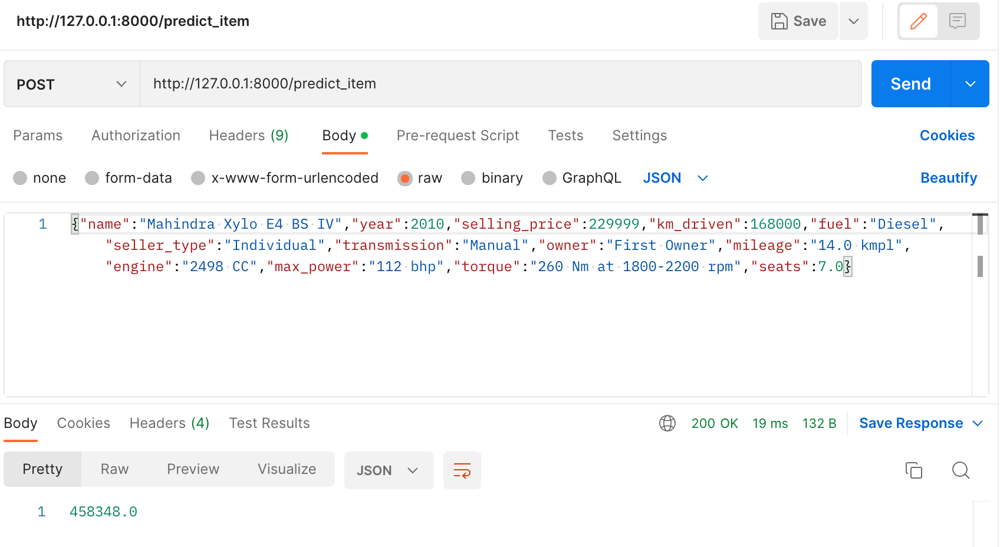
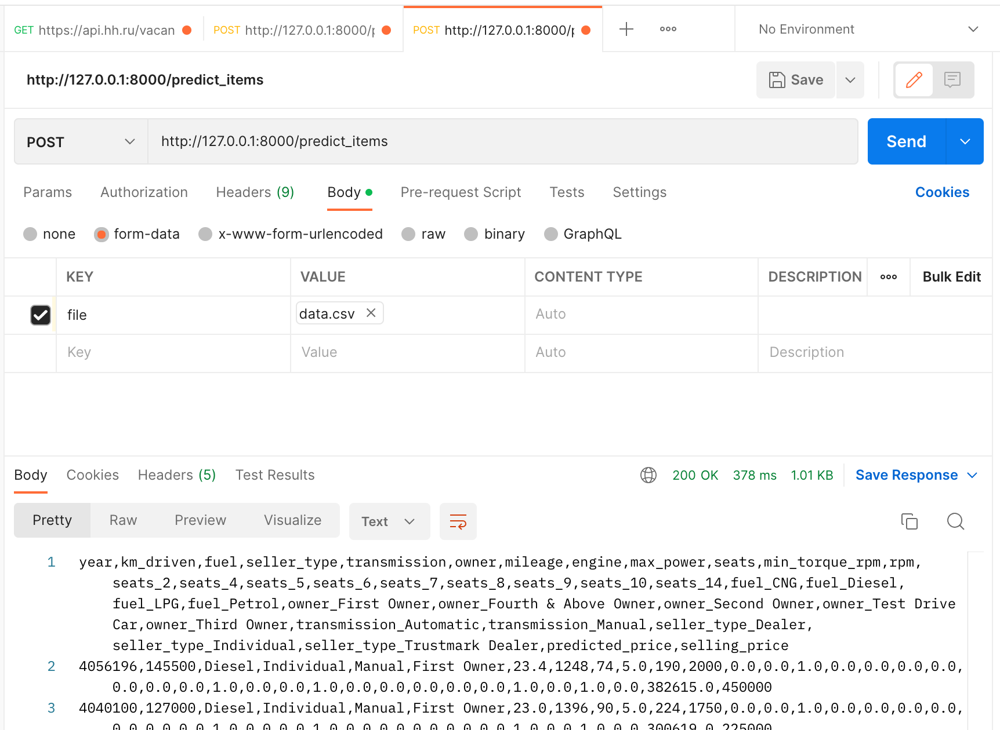

# Часть 6 (1 балл) | Оформление результатов

**Результаты вашей работы** необходимо разместить в своем Гитхабе. Под результатами понимаем следующее:
* ``.ipynb``-ноутбук со всеми проведёнными вами экспериментами (output'ы ячеек, разумеется, сохранить)
* ``.py``-файл с реализацией сервиса
* ``.pickle``-файл с сохранёнными весами модели, коэффициентами скейлинга и прочими числовыми значениями, которые могут понадобиться для инференса
* ``.md``-файл с выводами про проделанной вами работе:
    * что было сделано
    * с какими результатами
    * что дало наибольший буст в качестве
    * что сделать не вышло и почему (это нормально, даже хорошо😀)

**За что могут быть сняты баллы в этом пункте:**
* за отсутствие ``.pickle``-файла с весами использованной модели
* за недостаточную аналитику в ``.md``-файле
* за оформление и логику кода (в определённом смысле это тоже элемент оформления решения)

**Как будет выглядет проверка всего домашнего задания?**
1. Ассистент проходит по ссылке на (**открытый**) репозиторий из Энитаска
2. Смотрит ``readme.md``:
    * пожалуйста, приложите в него же скрины работы вашего сервиса -- собирать ваши проекты довольно времязатратно, но хочется убедиться, что всё работает
    * можете прислать screencast в ТГ
3. Просматривает ноутбук с pure-DS частью
4. Заглядывает в код сервиса
5. Хвалит

# Часть Благодарственная

Надеемся, вы честно проделали все пункты, а не просто пролистали досюда. Потому что здесь награда за старания. Пожалуйста, не стоит награждать себя до того, как закончите работать над домашкой.

https://drive.google.com/file/d/1LT06nyg9QgVi3r-D5BY-_mQ9TcJQFxJN/view?usp=share_link